In [1]:
import numpy as np
import os
import torch
import pickle
import json
from torchvision import transforms
from matplotlib import pyplot as plt
import random
import functools
import tqdm
from collections import defaultdict
from config import get_args
from retrieval import get_topk, load_model, get_dataset

from PIL import ImageOps, Image
from matplotlib import pyplot as plt
from wordcloud import WordCloud
import nltk
# nltk.download('stopwords')
from nltk.corpus import stopwords
# words to ignore in wordclouds
stopwords = set(stopwords.words('english'))

In [2]:
im2rec = pickle.load(open('im2rec_res.pkl', 'rb'))
rec2im = pickle.load(open('rec2im_res.pkl', 'rb'))

In [3]:
# load dataset (for display purposes)
dataset = pickle.load(open(os.path.join('/data/s2478846/data/traindata/test.pkl'), 'rb'))

In [4]:
# display utilities

def load_image(image_path):
    tfs = transforms.Compose([transforms.Resize(256), transforms.CenterCrop(256)])
    return tfs(Image.open(image_path).convert('RGB'))

def plot_image(dataset_sample):
    plt.imshow(get_image(dataset_sample))
    plt.axis('off')
    plt.show()

def get_image(dataset_sample):
    img_name = dataset_sample['images'][0]
    img_name = '/'.join(img_name[:4])+'/'+img_name
    return load_image(os.path.join('/data/s2478846/data', 'test', img_name))

def get_wordcloud(dataset_sample):
    recipe_text = ''
    recipe_text+=dataset_sample['title'].lower()
    recipe_text+='\n'.join(dataset_sample['ingredients']).lower()
    recipe_text+='\n'.join(dataset_sample['instructions']).lower()
    
    wordcloud = WordCloud(width=256, random_state = 1234, stopwords=stopwords, 
               height=256, background_color="white").generate(recipe_text)
    
    return Image.fromarray(wordcloud.to_array())

def plot_ranking(query, elements, dataset, mode = 'im2recipe'):
    height = 20
    N = len(elements) + 1
    fig, ax = plt.subplots(1,N, figsize=(height*N,height), gridspec_kw = {'wspace':0, 'hspace':0})
    if mode == 'im2recipe':
        img = get_image(dataset[query])
    else: 
        img = get_wordcloud(dataset[query])
    
    img_with_border = ImageOps.expand(img, border=10,fill='blue')
    ax[0].imshow(img_with_border)
    ax[0].axis('off')
    
    for i, element in enumerate(elements):
        if mode == 'recipe2im':
            img = get_image(dataset[element])
        else:
            img = get_wordcloud(dataset[element])
        if element == query:
            img = ImageOps.expand(img, border=10,fill='green')
        
        ax[i+1].imshow(img)
        ax[i+1].axis('off')
    plt.show()

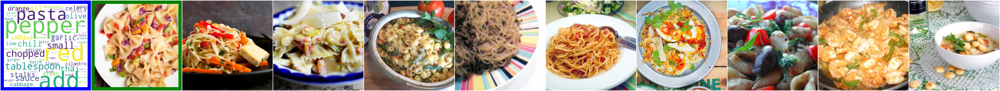

In [14]:
print('Recipe id: {}, Retrieved topk: {}'.format(recipe_id, top_10))
# recipe_id 83471d6472
plot_ranking(recipe_id, top_10, dataset, mode = 'recipe2im')

Recipe id: 3dea1d62bc, Retrieved topk: ['3dea1d62bc', 'e394db8819', 'a967dd2ac7', '77e9820dc4', '131719b31d', '806b976caf', '1842114807', '7ffc3ce307', 'a969910cd4', 'cb3d9d1789']


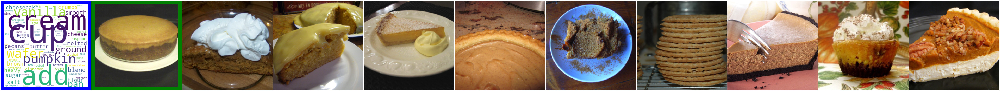

In [10]:
print('Recipe id: {}, Retrieved topk: {}'.format(recipe_id, top_10))
plot_ranking(recipe_id, top_10, dataset, mode = 'recipe2im')

Recipe id: 3dea1d62bc, Retrieved topk: ['3dea1d62bc', 'cb3d9d1789', '131719b31d', '26d202b0b5', '59c64b0c16', 'c2a573e7b8', '4e4bfd78d5', 'a967dd2ac7', '791d43e892', '3f3fb55c23']


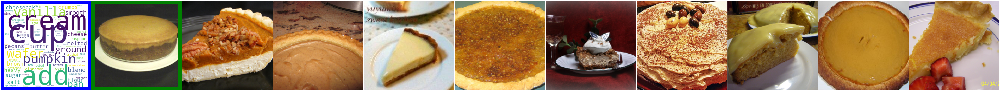

In [12]:
print('Recipe id: {}, Retrieved topk: {}'.format(recipe_id, h_top10))
plot_ranking(recipe_id, h_top10, dataset, mode = 'recipe2im')

Recipe id: 3dea1d62bc, Retrieved topk: ['3dea1d62bc', '131719b31d', 'cb3d9d1789', '7ffc3ce307', 'e394db8819', '4e4bfd78d5', 'a967dd2ac7', '1842114807', '77e9820dc4', '0ed0d7dd34']


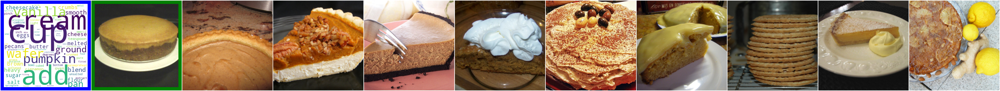

In [8]:
print('Recipe id: {}, Retrieved topk: {}'.format(recipe_id, top_10))
# recipe_id 83471d6472
plot_ranking(recipe_id, top_10, dataset, mode = 'recipe2im')

Recipe id: 17361bde0f, Retrieved topk: ['17361bde0f', '75e8df9d61', '66159ec27a', 'e20c1aa626', 'fd00343e28', '4f13583f3e', 'aae1301a13', '07bb3b6067', 'be3a4526ea', 'e641935bbf']


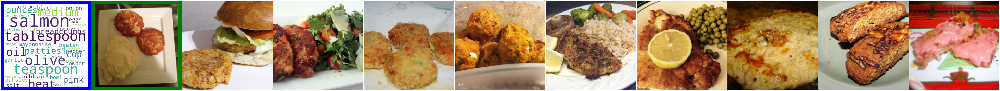

In [13]:
print('Recipe id: {}, Retrieved topk: {}'.format(recipe_id, top_10))
# recipe_id 83471d6472
plot_ranking(recipe_id, top_10, dataset, mode = 'recipe2im')

### Random sample 5 recipe to display

In [6]:
keys = list(im2rec.keys())
rep_ids = random.sample(keys, 5)

In [7]:
rep_ids

['02fcc86ea9', '97a848114e', '9de739d671', '3dcee4cdf4', '2e2b10df79']

### Image to text retrieval

Recipe ID: 02fcc86ea9, Retrieved Topk: ['02fcc86ea9', 'e9e17ddd5f', '272bcace4b', 'ec65532bc7', '5b0da44bd6', '1c84e9eeda', '2eb6028332', 'e3bbb0b91f', 'f52f965aef', '65a1325b5c']


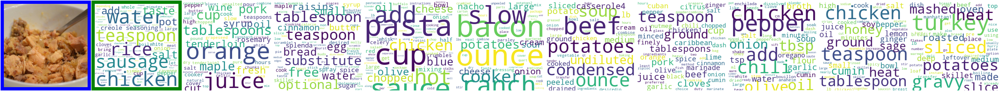

Recipe ID: 97a848114e, Retrieved Topk: ['157d3fce45', '581da6fce2', '87a16b1e4d', 'd3c3681ecc', '97a848114e', '84b37dc041', 'bf292e5a21', 'f369152e9f', 'd4a487e1d0', '778f3c0a59']


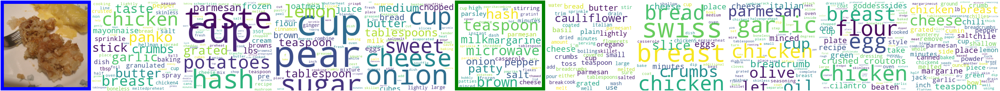

Recipe ID: 9de739d671, Retrieved Topk: ['a60db35a9a', 'be9161e154', '1df7d29211', 'f905a137c1', '9de739d671', 'cab50980cc', '87ae2c9524', '257f311907', 'd2bb78781e', '0fb7f66642']


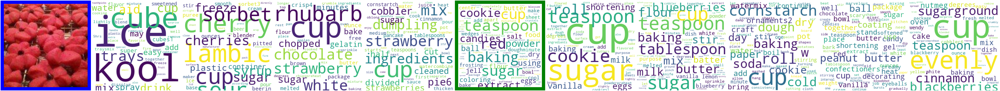

Recipe ID: 3dcee4cdf4, Retrieved Topk: ['3dcee4cdf4', '8a9fdae324', '12da18d9e5', '33fc09f753', '3a90aaa59f', '359fd5e65c', '0f3a7752a5', '639b556204', '5f2fd925a9', '8f3caca323']


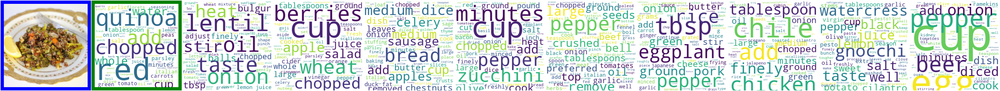

Recipe ID: 2e2b10df79, Retrieved Topk: ['2e2b10df79', '500a97a60a', 'd53325c985', '1bee9401c4', '53900b08e4', '563329e73d', '260ae50be8', 'b8085578ad', 'c74153ab17', '69818aace4']


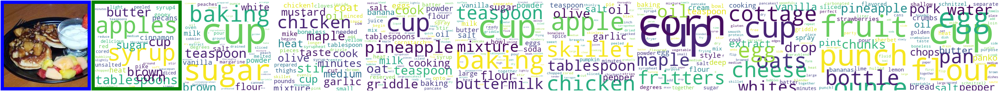

In [9]:
for recipe_id in rep_ids:
    top_10 = im2rec[recipe_id]
    print('Recipe ID: {}, Retrieved Topk: {}'.format(recipe_id, top_10))
    plot_ranking(recipe_id, top_10, dataset, mode = 'im2recipe')

### Text to image retrieval

Recipe ID: 02fcc86ea9, Retrieved Topk: ['02fcc86ea9', 'e9e17ddd5f', '272bcace4b', 'ec65532bc7', '5b0da44bd6', '1c84e9eeda', '2eb6028332', 'e3bbb0b91f', 'f52f965aef', '65a1325b5c']


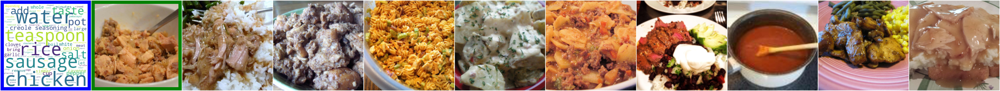

Recipe ID: 97a848114e, Retrieved Topk: ['157d3fce45', '581da6fce2', '87a16b1e4d', 'd3c3681ecc', '97a848114e', '84b37dc041', 'bf292e5a21', 'f369152e9f', 'd4a487e1d0', '778f3c0a59']


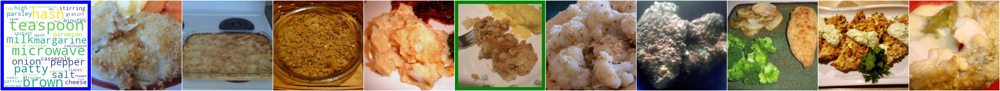

Recipe ID: 9de739d671, Retrieved Topk: ['a60db35a9a', 'be9161e154', '1df7d29211', 'f905a137c1', '9de739d671', 'cab50980cc', '87ae2c9524', '257f311907', 'd2bb78781e', '0fb7f66642']


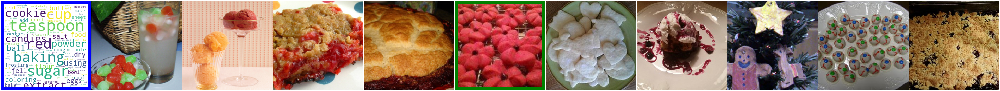

Recipe ID: 3dcee4cdf4, Retrieved Topk: ['3dcee4cdf4', '8a9fdae324', '12da18d9e5', '33fc09f753', '3a90aaa59f', '359fd5e65c', '0f3a7752a5', '639b556204', '5f2fd925a9', '8f3caca323']


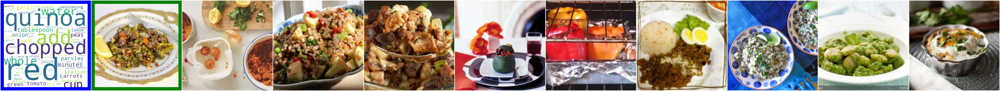

Recipe ID: 2e2b10df79, Retrieved Topk: ['2e2b10df79', '500a97a60a', 'd53325c985', '1bee9401c4', '53900b08e4', '563329e73d', '260ae50be8', 'b8085578ad', 'c74153ab17', '69818aace4']


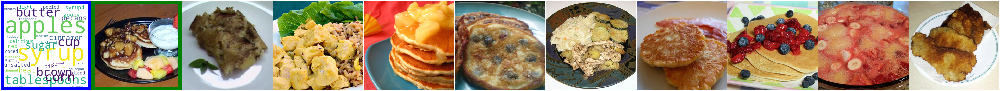

In [8]:
for recipe_id in rep_ids:
    top_10 = rec2im[recipe_id]
    print('Recipe ID: {}, Retrieved Topk: {}'.format(recipe_id, top_10))
    plot_ranking(recipe_id, top_10, dataset, mode = 'recipe2im')

In [10]:
dataset['d53325c985']

{'ingredients': ['1 tablespoon olive oil, or as needed',
  '2 pounds boneless chicken thighs, cut into small pieces, or more to taste',
  '3 cloves garlic, minced, or more to taste',
  '1/4 cup prepared yellow mustard',
  '1/4 cup maple syrup'],
 'title': "mike's maple chicken",
 'instructions': ['heat a skillet over medium heat and coat the inside with olive oil.',
  'add chicken and garlic; cook and stir until chicken begins to brown, about 5 minutes.',
  'drizzle mustard and maple syrup over chicken mixture and stir to evenly coat chicken.',
  'cook and stir chicken mixture over medium-low heat until chicken is no longer pink in the center and the sauce is thickened, 10 to 15 minutes more.'],
 'images': ['4bed7bb3d6.jpg', '70137aaceb.jpg']}

In [ ]:
dataset['2e2b10df79']